In [1]:
import anndata
import numpy as np
import sys
import torch
sys.path.insert(1, '../../../')
import velovae as vv
%load_ext autoreload
%autoreload 2

In [2]:
dataset = 'Pancreas'
import scvelo as scv
root = "/scratch/blaauw_root/blaauw1/gyichen"
#adata = scv.datasets.pancreas()
adata = anndata.read_h5ad(f'{root}/data/velovae/continuous/{dataset}/{dataset}.h5ad')

In [3]:
model_path_base = f'{root}/checkpoints/{dataset}'
figure_path_base = f'{root}/figures/{dataset}'
data_path = f'{root}/data/velovae/brode/{dataset}'
gene_plot = ['Cpe','Gng12', 'Ppp3ca', 'Smoc1']

# Train a Branching ODE

Graph Partition
Number of partitions:  1
Computing type-to-type transition probability
Obtaining the MST in each partition
Initialization using type-specific dynamical model.
Learning Rate based on Data Sparsity: 0.0002
------------------------ Train a Branching ODE ------------------------
               Alpha  Beta  Delta  Ductal  Epsilon  Ngn3 high EP  Ngn3 low EP  Pre-endocrine
Alpha            0.0   0.0    0.0     0.0      0.0           0.0          0.0            1.0
Beta             0.0   0.0    0.0     0.0      0.0           0.0          0.0            1.0
Delta            0.0   0.0    0.0     0.0      0.0           0.0          0.0            1.0
Ductal           0.0   0.0    0.0     1.0      0.0           0.0          0.0            0.0
Epsilon          0.0   0.0    0.0     0.0      0.0           0.0          0.0            1.0
Ngn3 high EP     0.0   0.0    0.0     0.0      0.0           0.0          1.0            0.0
Ngn3 low EP      0.0   0.0    0.0     1.0      0.0       

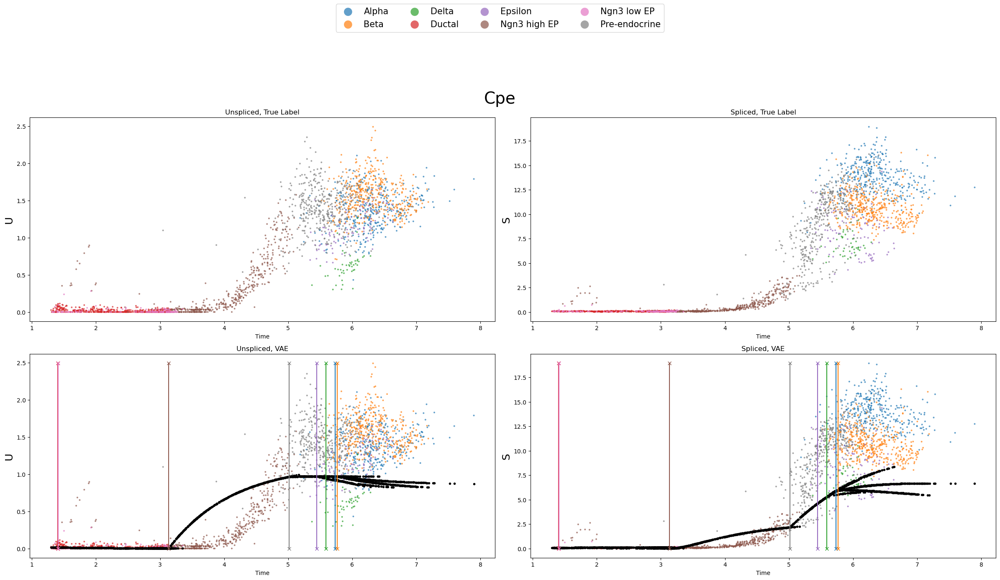

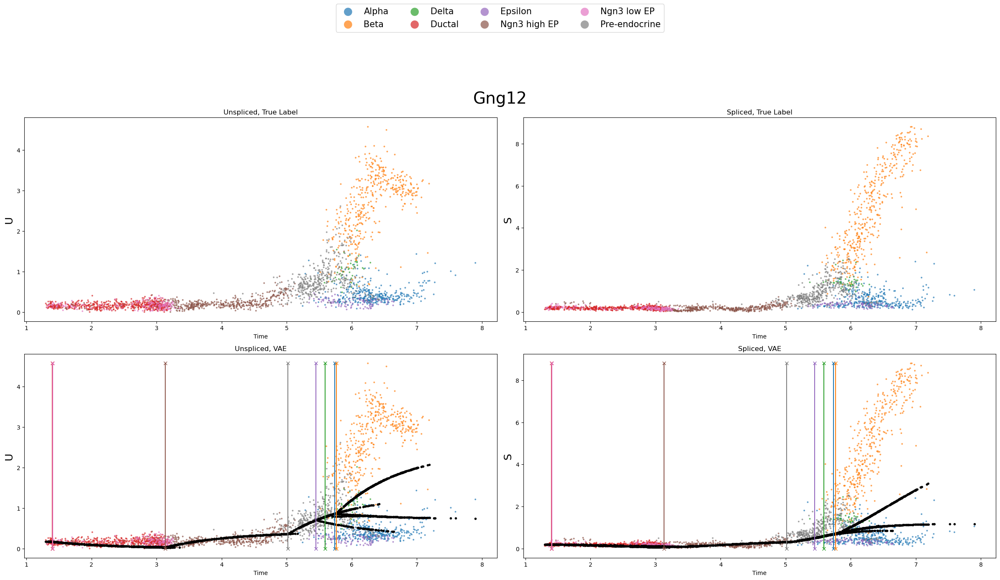

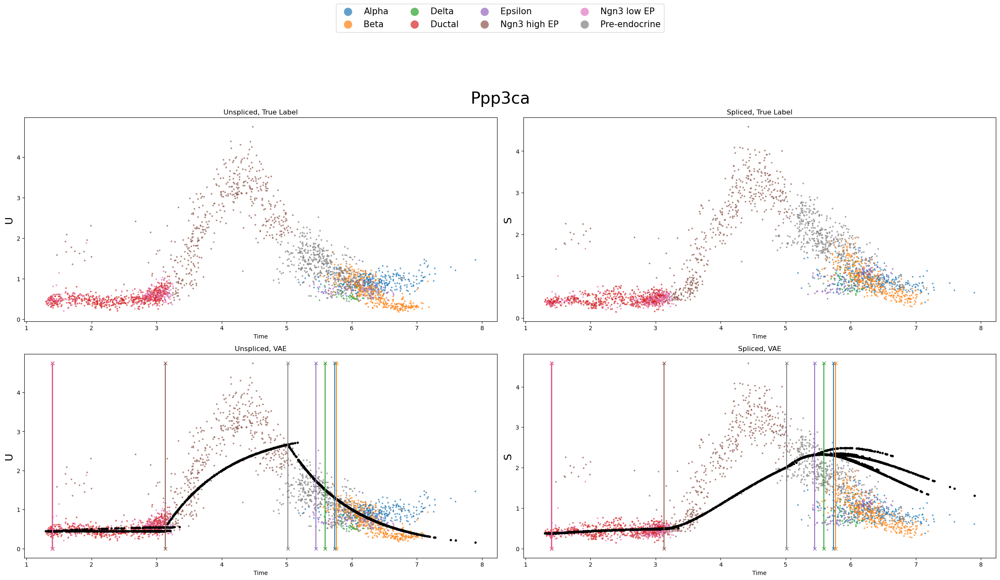

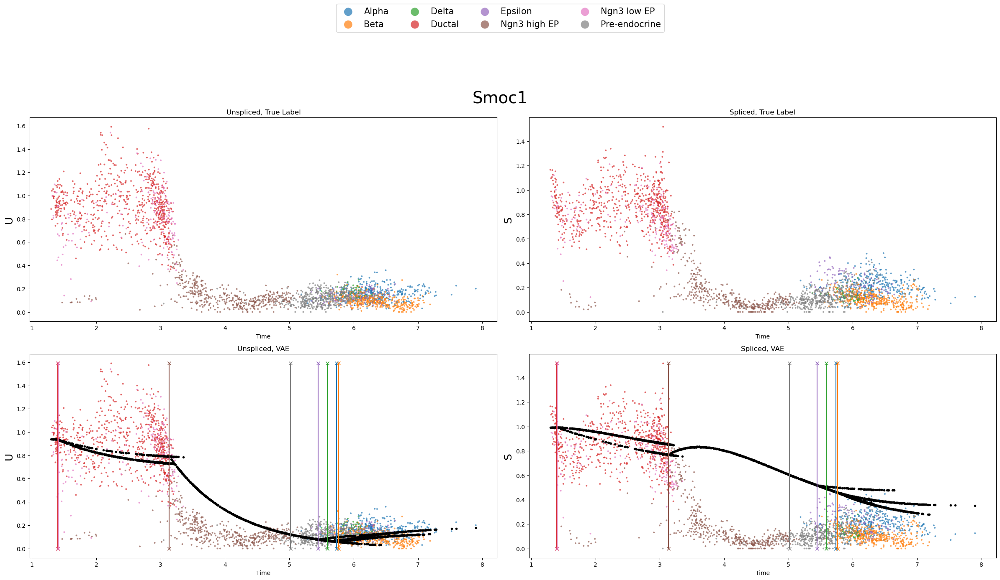

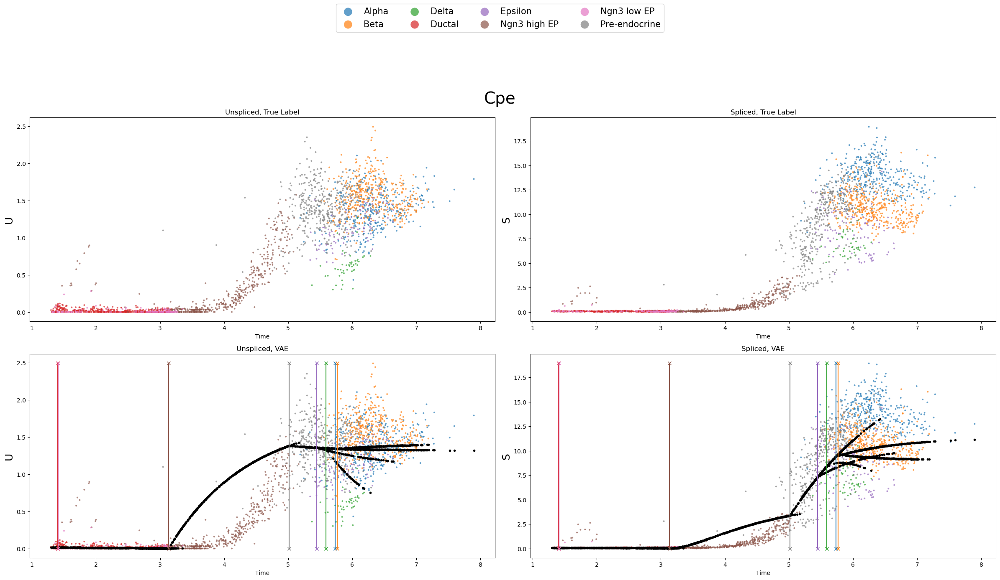

...

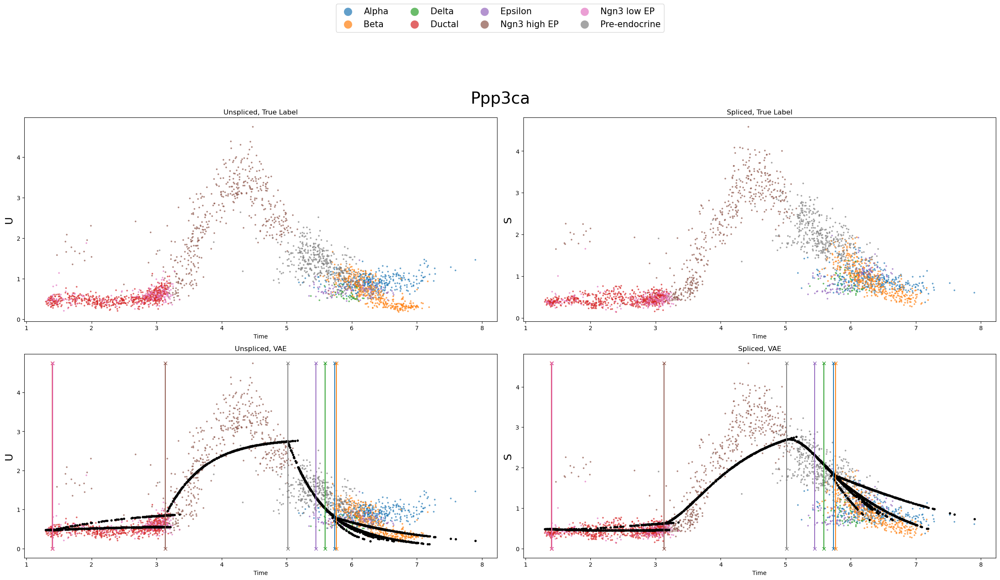

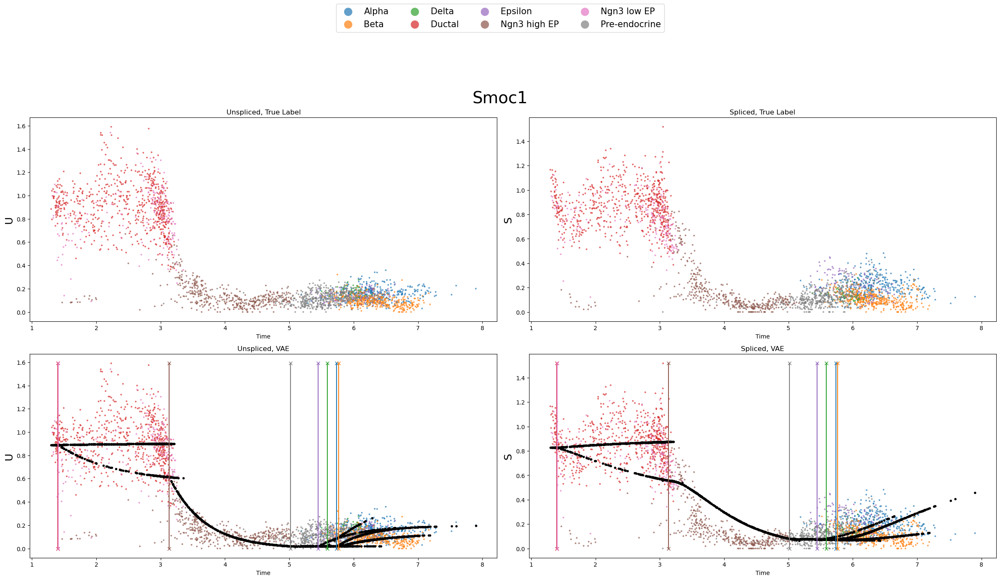

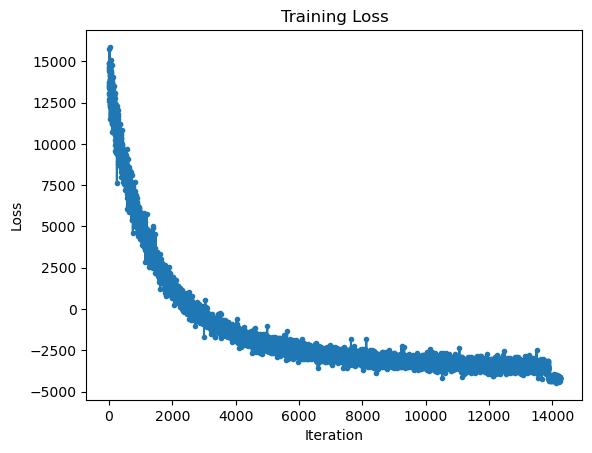

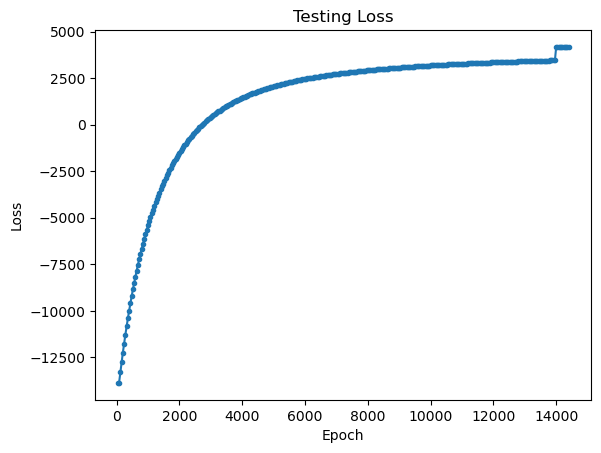

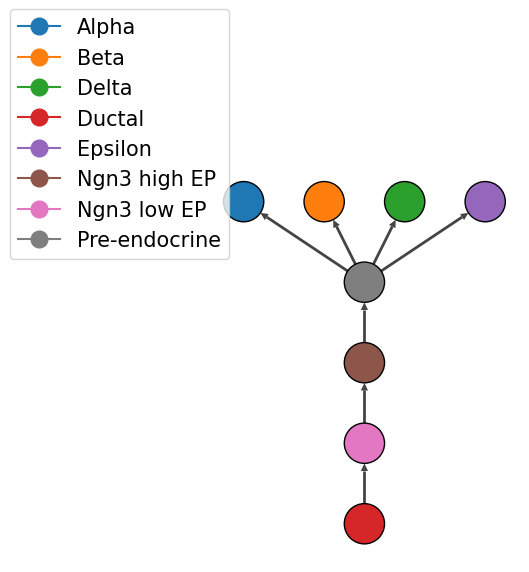

In [5]:
figure_path = f'{figure_path_base}/BrODE'
model_path = f'{model_path_base}/BrODE'

torch.manual_seed(2022)
np.random.seed(2022)
brode = vv.BrODE(adata,
                 'clusters',
                 'velovae_time',
                 'velovae_z',
                 param_key='velovae',
                 device='cuda:0')

brode.train(adata,
            'velovae_time',
            'clusters',
            plot=True,
            gene_plot=gene_plot,
            figure_path=figure_path)

brode.save_model(model_path, 'brode')
brode.save_anndata(adata, 'brode', data_path, file_name=f'{dataset}.h5ad')

vv.plot_transition_graph(adata, save=f'{figure_path_base}/transition.png')

# Evaluation

---   Plotting  Results   ---
computing velocity graph (using 1/32 cores)


  0%|          | 0/3696 [00:00<?, ?cells/s]

    finished (0:00:30) --> added 
    'brode_velocity_graph', sparse matrix with cosine correlations (adata.uns)
computing velocity embedding
    finished (0:00:00) --> added
    'brode_velocity_umap', embedded velocity vectors (adata.obsm)
saving figure to file /scratch/blaauw_root/blaauw1/gyichen/figures/Pancreas/eval_brode_stream.png


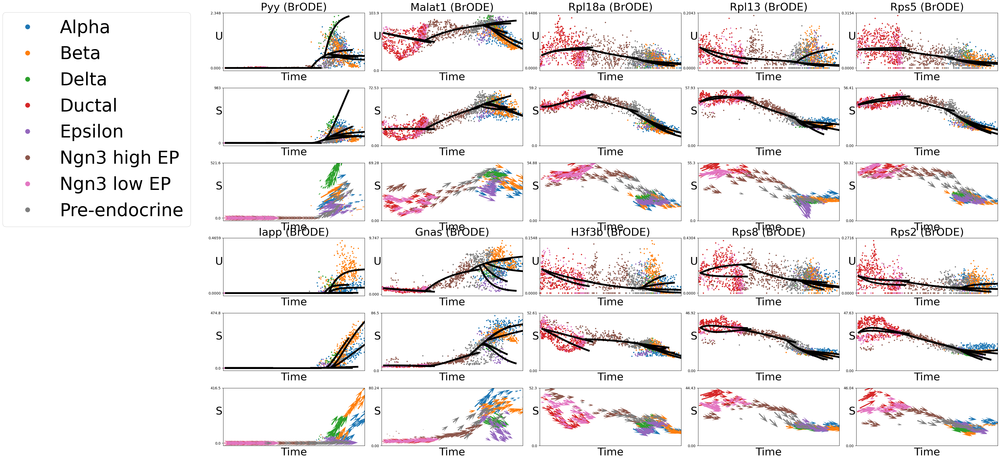

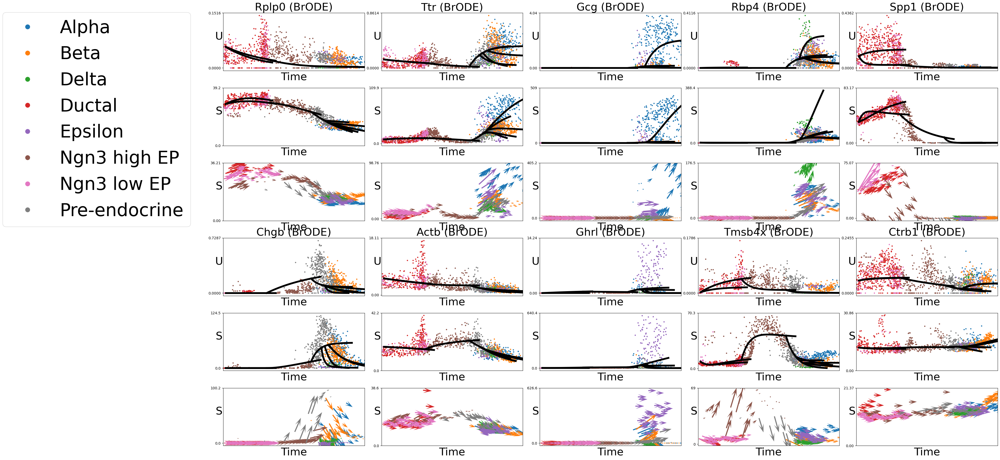

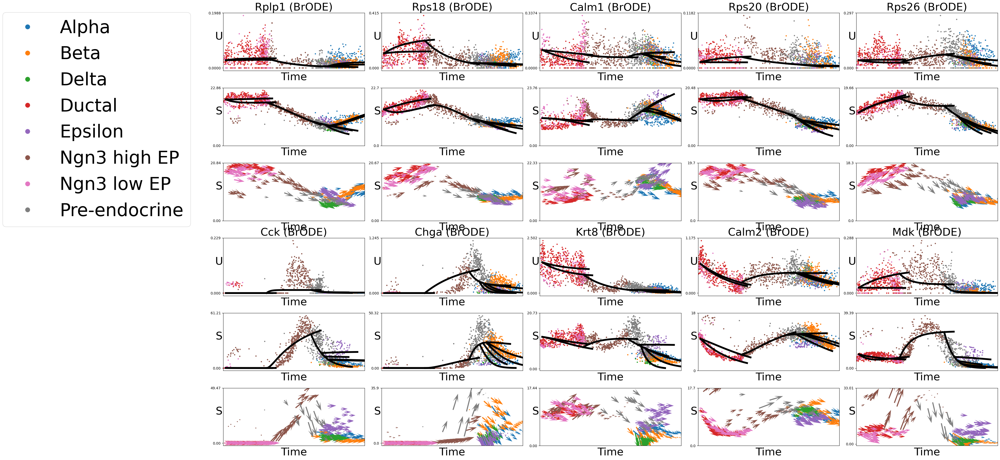

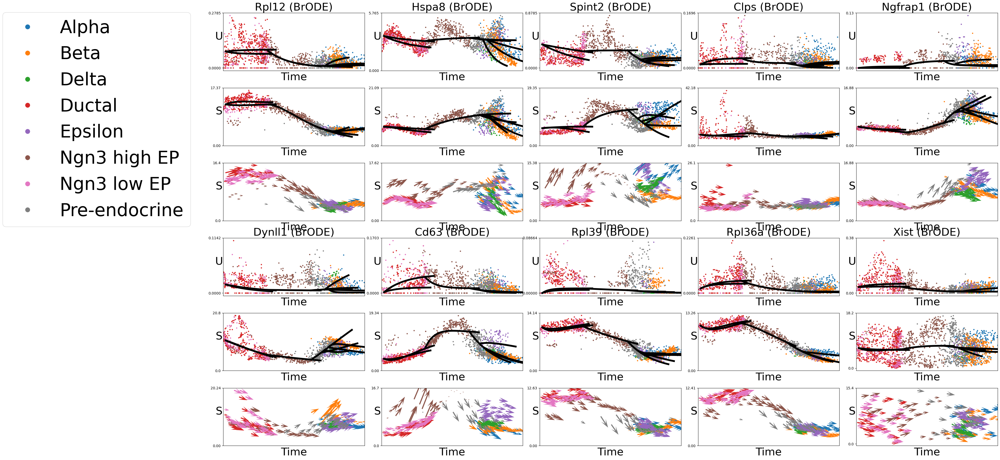

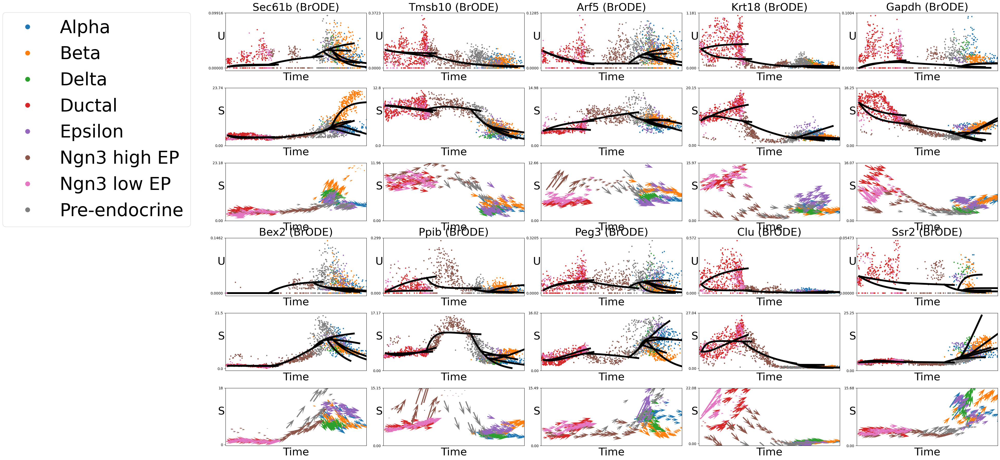

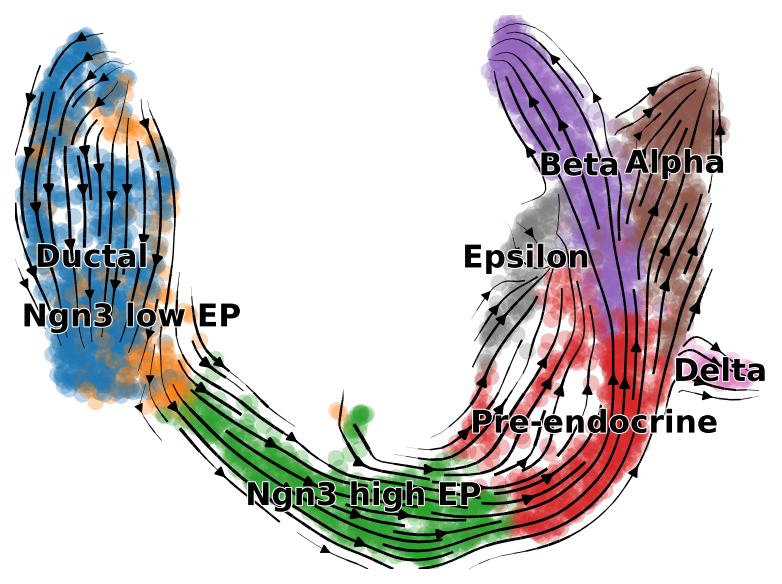

(None, None)

In [6]:
gene_plot = vv.sample_genes(adata, 50, 'means')
vv.post_analysis(adata,
                 'eval',
                 ['BrODE'],
                 ['brode'],
                 compute_metrics=False,
                 genes=gene_plot,
                 plot_type = ['gene', 'stream'],
                 grid_size=(2,5),
                 figure_path=figure_path_base)